# Features Preprocessing

In [20]:
import matplotlib.pyplot as plt
import numpy as np
import joblib

import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [21]:
X_train = joblib.load("Data/Xtrain2.pkl")
Y_train = np.load('Data/Ytrain2.npy')

print(X_train.shape)
print(Y_train.shape)

(444, 3)
(14,)


In [22]:
X_train.head()

,Patient_Id,Exercise_Id,Skeleton_Sequence
0,1,E1,"[[-0.006559493, -0.596473992, 0.008439806, -0...."
1,1,E1,"[[-0.013246231, -0.53470093, 0.001707567, -0.5..."
2,1,E1,"[[0.01791355, -0.56308651, 0.03354283, -0.5888..."
3,2,E1,"[[-0.002102487, -0.598189116, 0.014012374, -0...."
4,3,E1,"[[0.019835064, -0.562546909, 0.037609391, -0.5..."


In [23]:
print(X_train.info())

<class 'pandas.core.frame.DataFrame'>
Index: 444 entries, 0 to 443
Data columns (total 3 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Patient_Id         444 non-null    int64 
 1   Exercise_Id        444 non-null    object
 2   Skeleton_Sequence  444 non-null    object
dtypes: int64(1), object(2)
memory usage: 13.9+ KB
None


In [24]:
row0 = X_train.iloc[0]
print("Patient_Id:", row0["Patient_Id"])
print("Exercise_Id:", row0["Exercise_Id"])

seq = row0["Skeleton_Sequence"]
print("Type of sequence:", type(seq))
print("Number of frames:", len(seq))
print("Shape of first frame:", np.array(seq[0]).shape)

# print first frame's coordinates
print("First frame data:\n", np.array(seq[0]))


Patient_Id: 1
Exercise_Id: E1
Type of sequence: <class 'numpy.ndarray'>
Number of frames: 172
Shape of first frame: (66,)
First frame data:
 [-0.00655949 -0.59647399  0.00843981 -0.61798137  0.01269663 -0.61725789
  0.01024522 -0.61710554 -0.0117649  -0.62162453 -0.00902208 -0.62022436
 -0.00284956 -0.61171073  0.06780402 -0.5840829  -0.05951675 -0.53876591
  0.03233525 -0.58220089  0.00301737 -0.54602623  0.18456568 -0.41156354
 -0.15180205 -0.46365374  0.2516011  -0.21599793 -0.24636093 -0.20106906
  0.19698244 -0.03443749 -0.2270416  -0.03480084  0.17161025  0.00996891
 -0.18781522  0.0058936   0.12560928  0.00327489 -0.14442128 -0.03461261
  0.17721528 -0.00960131 -0.20238565 -0.03737459  0.10517266 -0.00066925
 -0.10269293 -0.00077146  0.29016018  0.196964   -0.15774922  0.14674969
  0.23314379  0.58861053 -0.16147123  0.56826979  0.20826535  0.62521839
 -0.16590011  0.60398626  0.26001447  0.6622237  -0.22975068  0.62196881]


In [25]:
Y_train

array([0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1])

In [26]:
# --- Connections dictionary ---
connections = {
    'trunk': [(11, 12), (11, 23), (12, 24), (23, 24)],
    'right_arm': [(12, 14), (14, 16), (22, 16), (20, 16), (20, 18), (18, 16)],
    'left_arm': [(11, 13), (13, 15), (21, 15), (15, 19), (19, 17), (17, 15)],
    'right_leg': [(23, 25), (25, 27), (27, 31), (31, 29), (29, 27)],
    'left_leg': [(24, 26), (26, 28), (28, 30), (30, 32), (28, 32)]
}

colors = {
    'trunk': 'blue',
    'right_arm': 'red',
    'left_arm': 'green',
    'right_leg': 'orange',
    'left_leg': 'purple'
}

head_indices = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

# --- Exercise dictionary ---
exercise_names = {
    "E1": "Brushing Hair",
    "E2": "Brushing Teeth",
    "E3": "Wash the Face",
    "E4": "Put on Socks",
    "E5": "Hip Flexion"
}

Patient 1 has 28 exercise recordings:
['E1' 'E2' 'E3' 'E4' 'E5']


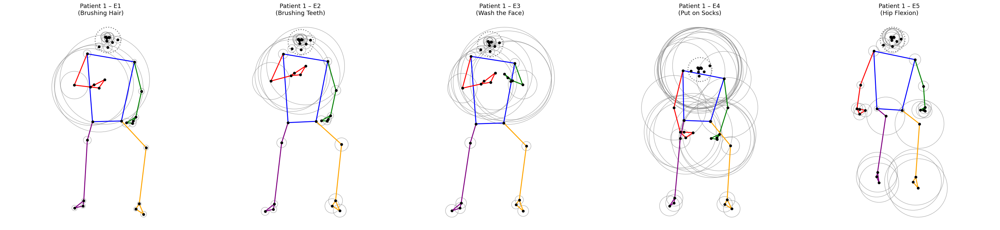

In [27]:
# --- Select all exercises for Patient 1 ---
patient_id = 1
patient_rows = X_train[X_train["Patient_Id"] == patient_id]

print(f"Patient {patient_id} has {len(patient_rows)} exercise recordings:")
print(patient_rows["Exercise_Id"].unique())

# --- Create a figure with one subplot per exercise ---
exercises = patient_rows["Exercise_Id"].unique()
fig, axes = plt.subplots(1, len(exercises), figsize=(6 * len(exercises), 7))

if len(exercises) == 1:
    axes = [axes]  # ensure iterable

for ax, exercise_id in zip(axes, exercises):
    seqs = patient_rows[patient_rows["Exercise_Id"] == exercise_id]["Skeleton_Sequence"].values

    # Concatenate all frames from all trials of this exercise
    frames = np.vstack(seqs)  # shape (T_total, 66)
    frames = frames.reshape(-1, 33, 2)

    # Compute mean and variance for each joint
    mean_pose = frames.mean(axis=0)      # (33, 2)
    var_pose = frames.var(axis=0)        # (33, 2)

    # Extract x, y (invert y for human-like orientation)
    x = mean_pose[:, 0]
    y = -mean_pose[:, 1]

    # --- Compute head circle ---
    head_x = x[head_indices]
    head_y = y[head_indices]
    center_x = head_x.mean()
    center_y = head_y.mean()
    radius = np.max(np.sqrt((head_x - center_x)**2 + (head_y - center_y)**2)) * 1.15

    # --- Plot skeleton lines ---
    for part, segs in connections.items():
        for a, b in segs:
            ax.plot([x[a], x[b]], [y[a], y[b]], c=colors[part], lw=2)

    # --- Plot joints and variance circles ---
    ax.scatter(x, y, c="black", s=25, zorder=3)
    for i in range(33):
        vx, vy = np.sqrt(var_pose[i])  # std deviation per coord
        var_radius = np.sqrt(vx**2 + vy**2) * 1.5
        circ = patches.Circle((x[i], y[i]), var_radius,
                              fill=False, color="gray", alpha=0.6, lw=1)
        ax.add_patch(circ)

    # --- Draw head circle ---
    head_circle = patches.Circle((center_x, center_y), radius,
                                 fill=False, linestyle="dotted",
                                 edgecolor="gray", lw=2)
    ax.add_patch(head_circle)

    # --- Style ---
    exercise_meaning = exercise_names.get(exercise_id, exercise_id)
    ax.set_title(f"Patient {patient_id} – {exercise_id}\n({exercise_meaning})", fontsize=13)
    ax.axis("equal")
    ax.axis("off")

plt.tight_layout()
plt.show()

In [28]:
# --- Select patient ---
patient_id = 1  # Change this to analyze a different patient

patient_rows = X_train[X_train["Patient_Id"] == patient_id]
exercises = sorted(patient_rows["Exercise_Id"].unique())

print(f"Patient {patient_id} has {len(exercises)} exercises:")
print(exercises)
print()

# --- Generate and display one animation per exercise ---
for exercise_id in exercises:
    # Get first recording of this exercise
    exercise_rows = patient_rows[patient_rows["Exercise_Id"] == exercise_id]
    seq = np.array(exercise_rows.iloc[0]["Skeleton_Sequence"])
    
    # --- Create figure ---
    fig, ax = plt.subplots(figsize=(7, 7))
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_aspect('equal')
    exercise_meaning = exercise_names.get(exercise_id, exercise_id)
    ax.set_title(f"Patient {patient_id} | {exercise_id}\n({exercise_meaning})", fontsize=14, fontweight='bold')
    ax.axis('off')
    
    # --- Initialize skeleton lines ---
    lines = []
    for part, conns in connections.items():
        for (i, j) in conns:
            (line,) = ax.plot([], [], lw=2.5, color=colors[part])
            lines.append(line)
    
    # --- Points for joints ---
    points = ax.scatter([], [], c='black', s=30, zorder=3)
    
    # --- Head circle ---
    circle = patches.Circle((0, 0), 0.05, fill=False, linestyle='dotted', 
                           edgecolor='gray', lw=2)
    ax.add_patch(circle)
    
    # --- Frame counter ---
    frame_text = ax.text(0.02, 0.98, '', transform=ax.transAxes, 
                        fontsize=10, verticalalignment='top',
                        bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    
    # --- Update function per frame ---
    def update(frame_idx, seq=seq, lines=lines, points=points, circle=circle, 
               frame_text=frame_text):
        coords = seq[frame_idx].reshape(-1, 2)
        x = coords[:, 0]
        y = -coords[:, 1]  # flip Y for natural human orientation
        
        # Update skeleton lines
        k = 0
        for part, conns in connections.items():
            for (i, j) in conns:
                lines[k].set_data([x[i], x[j]], [y[i], y[j]])
                k += 1
        
        # Update joint points
        points.set_offsets(np.c_[x, y])
        
        # Compute head circle
        head_x = x[head_indices]
        head_y = y[head_indices]
        center_x = head_x.mean()
        center_y = head_y.mean()
        radius = np.max(np.sqrt((head_x - center_x)**2 + (head_y - center_y)**2)) * 1.15
        
        # Update circle
        circle.center = (center_x, center_y)
        circle.set_radius(radius)
        
        # Update frame counter
        frame_text.set_text(f"Frame: {frame_idx + 1}/{len(seq)}")
        
        return lines + [points, circle, frame_text]
    
    # --- Animate ---
    ani = FuncAnimation(fig, update, frames=len(seq), interval=60, blit=True)
    plt.close(fig)
    
    print(f"Exercise {exercise_id} ({exercise_names.get(exercise_id, exercise_id)})")
    display(HTML(ani.to_jshtml()))
    print("---\n")

Patient 1 has 5 exercises:
['E1', 'E2', 'E3', 'E4', 'E5']

Exercise E1 (Brushing Hair)


---

Exercise E2 (Brushing Teeth)


---

Exercise E3 (Wash the Face)


---

Exercise E4 (Put on Socks)


---

Exercise E5 (Hip Flexion)


---

